# Xenopus Embryogenesis

Original publication: *The dynamics of gene expression in vertebrate embryogenesis at single-cell resolution* by Briggs et al., Science (2018). Data obtained from https://tome.gs.washington.edu/. The rds files were first comverted to anndata objects using R_convert_seurat_to_anndata.ipynb.

## Basic setup

In [2]:
%load_ext autoreload
%autoreload 2

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


In [4]:
import Concord as ccd
import torch
import scanpy as sc
import warnings

warnings.filterwarnings('ignore')

data_path = "../data/frog_tome/"
adata_file_list = ccd.ul.list_adata_files(data_path)

#adata = ccd.ul.read_and_concatenate_adata(adata_file_list, merge='unique', add_dataset_col=True, output_file=f'{data_path}/frog_tome_combined.h5ad')
adata = sc.read(f'{data_path}/frog_tome_combined.h5ad')

In [5]:
import pandas as pd
pd.crosstab(adata.obs['group'], adata.obs['stage'])

stage,S8,S10,S11,S12,S13,S14,S16,S18,S20,S22
group,,,,,,,,,,
Clutch_1,875,5927,0,5378,0,4459,4871,4879,5521,7572
Clutch_2,318,0,2656,0,0,0,0,0,0,0
Clutch_3,0,0,11986,0,0,0,0,0,0,0
Clutch_4,0,0,0,6440,8478,4031,0,0,0,0
Clutch_5,0,0,0,0,0,0,7209,0,0,13253
Clutch_6,0,0,0,0,0,0,0,6517,9753,13510


In [6]:
# Check GPU availability and cuda version
import os
os.system('nvidia-smi')

Tue Oct  1 14:23:29 2024       
+---------------------------------------------------------------------------------------+
| NVIDIA-SMI 535.54.03              Driver Version: 535.54.03    CUDA Version: 12.2     |
|-----------------------------------------+----------------------+----------------------+
| GPU  Name                 Persistence-M | Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp   Perf          Pwr:Usage/Cap |         Memory-Usage | GPU-Util  Compute M. |
|                                         |                      |               MIG M. |
|=========================================+======================+======================|
|   0  NVIDIA GeForce GTX 1080        Off | 00000000:02:00.0 Off |                  N/A |
| 42%   63C    P2              63W / 180W |   8112MiB /  8192MiB |    100%      Default |
|                                         |                      |                  N/A |
+-----------------------------------------+----------------------+--

0

In [6]:
import time
from pathlib import Path
proj_name = "concord_xenopus_embryogenesis"
save_dir = f"../save/dev_{proj_name}-{time.strftime('%b%d')}/"
save_dir = Path(save_dir)
save_dir.mkdir(parents=True, exist_ok=True)
device = torch.device('cuda:2' if torch.cuda.is_available() else 'cpu')
seed = 0

## Standard Scanpy pipeline

In [7]:
import scanpy as sc
adata_sc = adata.copy()
sc.pp.normalize_total(adata_sc, target_sum=1e4)  # Normalize each cell to have the same total count
sc.pp.log1p(adata_sc)  # Logarithmize the data
sc.pp.highly_variable_genes(adata_sc, n_top_genes=10000)  # Identify highly variable genes
sc.tl.pca(adata, svd_solver="arpack")
sc.pp.neighbors(adata_sc, n_neighbors=30)  
sc.tl.umap(adata_sc, min_dist=0.1)
adata.obsm = adata_sc.obsm # copy umap coordinates to the original adata object

In [8]:
import numpy as np
adata.obs['stage_numeric'] = adata.obs['stage'].str.extract(r'(\d+\.?\d*)').astype(float)
adata.obs['log_nFeature'] = np.log(adata.obs['nFeature_RNA'])

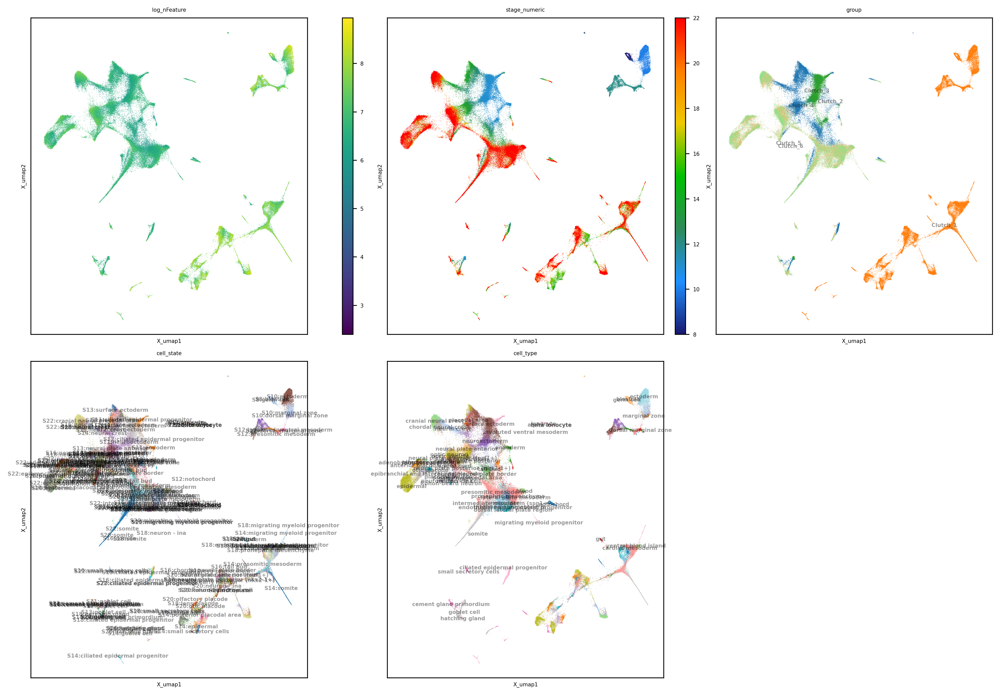

In [9]:
show_basis = 'X_umap'
file_suffix = f"{proj_name}_{time.strftime('%b%d-%H%M')}"
show_cols = ['log_nFeature', 'stage_numeric', 'group', 'cell_state', 'cell_type']
pal = {'log_nFeature':'viridis', 'stage_numeric':'BlueGreenRed', 'group':'tab20', 'cell_state':'tab20', 'cell_type':'tab20'}
ccd.pl.plot_embedding(
    adata, show_basis, show_cols, pal = pal, figsize=(13,9), dpi=300, ncols=3, font_size=5, point_size=.5, alpha=1.0, text_alpha=0.4, legend_loc='on data',
    save_path=save_dir / f"{show_basis}_{file_suffix}.png"
)

## (Optional) Define feature input and estimate dropout rate in data

Dropout is one of the major patterns in single cell data. Even nearby cells can have significant proportion of non-overlapping non-zero genes, which could be due to technical drop-out or real biology (genes stochastically turned on or off). Concord 'augments' the data by introducing dropout to each of the cell, and use contrastive learning to 'self-supervise' the model to learn the cell identity. The augment dropout probability can be custom-defined, or be estimated based on the average dropout rate in the current data. Here we provide a detailed example how this is calculated:

Concord.utils.feature_selector - INFO - Selecting highly variable features with flavor seurat_v3...
Concord.utils.preprocessor - INFO - Normalizing total counts ...
Concord.utils.preprocessor - INFO - Log1p transforming ...
Concord.utils.preprocessor - INFO - Filtering features with provided list (10000 features)...
Concord - INFO - Using existing embedding 'X_pca' from adata.obsm


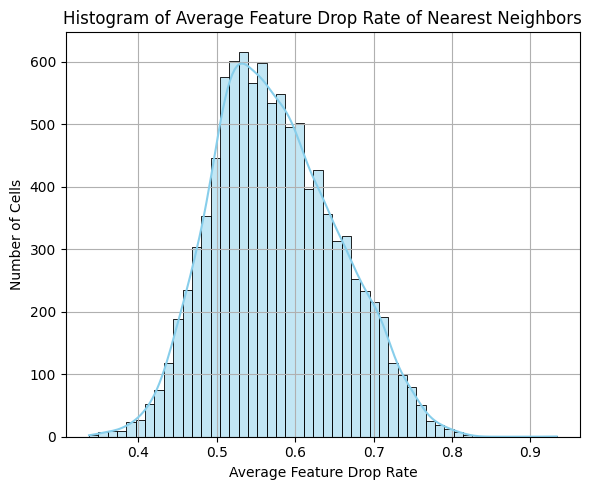

Concord - INFO - Average feature drop rate of nearest neighbors: 0.5749722581863171
0.5749722581863171


In [35]:
# Select top variably expressed/accessible features for analysis (other methods besides seurat_v3 available)
output_key = 'Concord'
feature_list = ccd.ul.select_features(adata, n_top_features=10000, flavor='seurat_v3', subsample_frac = 0.5) # subsample 50% of data for faster VEG computation
# Determine augmentation mask probabilities based on estimated dropout rate from knn neighbors
aug_prob = ccd.ul.estimate_aug_mask_prob(adata, input_feature = feature_list, n_samples = 10000, return_mean=True, plotting=True)
print(aug_prob)

## Run Concord

Based on the check above, we will use embryo_id as the 'domain_key' for batch integration. 

In [43]:
cur_ccd = ccd.Concord(adata=adata, 
                      input_feature=feature_list, # top 10000 VEGs selected above
                      domain_key='group', # key indicating batch
                      latent_dim=300, # latent space dimension
                      encoder_dims=[1000], # encoder architecture
                      decoder_dims=[1000], # decoder architecture
                      augmentation_mask_prob = 0.4, # augmentation mask probability, estimated above or set to between 0.1 and 0.7
                      seed=seed, 
                      p_intra_domain = 1.0,
                      verbose=True, # print training progress
                      device=device) # device to run on

# Encode data, saving the latent embedding in adata.obsm['Concord']
file_suffix = f"{proj_name}_{time.strftime('%b%d-%H%M')}"
output_key = 'Concord'
cur_ccd.encode_adata(input_layer_key='X_log1p', output_key=output_key)

# Save the latent embedding to a filem, so that it can be loaded later
ccd.ul.save_obsm_to_hdf5(cur_ccd.adata, save_dir / f"obsm_{file_suffix}.h5")

Concord - INFO - Setting sampler_knn to 2472 to be 1/50 the number of cells in the dataset. You can change this value by setting sampler_knn in the configuration.
Concord - INFO - Column 'group' is already of type: category
Concord - INFO - Unused levels dropped for column 'group'.
Concord - INFO - Encoder input dim: 10000
Concord - INFO - Decoder input dim: 308
Concord - INFO - Model loaded to device: cuda:2
Concord - INFO - Total number of parameters: 20634948
Concord.model.dataloader - INFO - Preprocessing adata...
Concord.utils.preprocessor - INFO - Normalizing total counts ...
Concord.utils.preprocessor - INFO - Log1p transforming ...


Concord.utils.preprocessor - INFO - Filtering features with provided list (10000 features)...
Concord.model.anndataset - INFO - Initialized dataset with 123633 samples. Data structure: ['input', 'domain', 'idx']
Concord.model.dataloader - INFO - Using existing embedding 'X_pca' from adata.obsm
Concord.model.knn - INFO - Using FAISS CPU index.
Concord.model.knn - INFO - Building Faiss IVF index. nprobe=10
Concord.model.knn - INFO - Using FAISS CPU index.
Concord.model.dataloader - INFO - Number of unique_domains: 6
Concord.model.dataloader - INFO - Final p_intra_domain values: Clutch_1: 1.00, Clutch_2: 1.00, Clutch_3: 1.00, Clutch_4: 1.00, Clutch_5: 1.00, Clutch_6: 1.00
Concord - INFO - Starting epoch 1/5
Concord - INFO - Processing chunk 1/1 for epoch 1
Concord - INFO - Number of samples in train_dataloader: 123633


Epoch 0 Training: 1929it [00:48, 39.81it/s, loss=3.53]

Concord - INFO - Epoch   0 | Train Loss: 3.75, MSE: 0.16, CLASS: 0.00, CONTRAST: 3.59, IMPORTANCE: 0.00


Concord - INFO - Starting epoch 2/5
Concord - INFO - Processing chunk 1/1 for epoch 2
Concord - INFO - Number of samples in train_dataloader: 123633


Epoch 1 Training: 100%|██████████| 1929/1929 [00:50<00:00, 37.89it/s, loss=3.49]

Concord - INFO - Epoch   1 | Train Loss: 3.61, MSE: 0.15, CLASS: 0.00, CONTRAST: 3.46, IMPORTANCE: 0.00
Concord - INFO - Starting epoch 3/5
Concord - INFO - Processing chunk 1/1 for epoch 3
Concord - INFO - Number of samples in train_dataloader: 123633



Epoch 2 Training: 100%|██████████| 1929/1929 [00:49<00:00, 39.09it/s, loss=3.5] 

Concord - INFO - Epoch   2 | Train Loss: 3.58, MSE: 0.15, CLASS: 0.00, CONTRAST: 3.43, IMPORTANCE: 0.00
Concord - INFO - Starting epoch 4/5
Concord - INFO - Processing chunk 1/1 for epoch 4
Concord - INFO - Number of samples in train_dataloader: 123633



Epoch 3 Training: 100%|██████████| 1929/1929 [00:49<00:00, 39.01it/s, loss=3.45]

Concord - INFO - Epoch   3 | Train Loss: 3.56, MSE: 0.15, CLASS: 0.00, CONTRAST: 3.42, IMPORTANCE: 0.00


Concord - INFO - Starting epoch 5/5
Concord - INFO - Processing chunk 1/1 for epoch 5
Concord - INFO - Number of samples in train_dataloader: 123633


Epoch 4 Training: 100%|██████████| 1929/1929 [00:50<00:00, 38.56it/s, loss=3.51]

Concord - INFO - Epoch   4 | Train Loss: 3.55, MSE: 0.14, CLASS: 0.00, CONTRAST: 3.41, IMPORTANCE: 0.00


Concord - INFO - Model saved to save/final_model.pth
Concord - INFO - Final model saved at: save/final_model.pth; Configuration saved at: save/config.json.
Concord.model.dataloader - INFO - Preprocessing adata...
Concord.utils.preprocessor - INFO - Normalizing total counts ...
Concord.utils.preprocessor - INFO - Log1p transforming ...
Concord.utils.preprocessor - INFO - Filtering features with provided list (10000 features)...
Concord.model.anndataset - INFO - Initialized dataset with 123633 samples. Data structure: ['input', 'domain', 'idx']
Concord - INFO - Predicting for chunk 1/1


## Visualize Concord latent with UMAP

### 2D UMAP

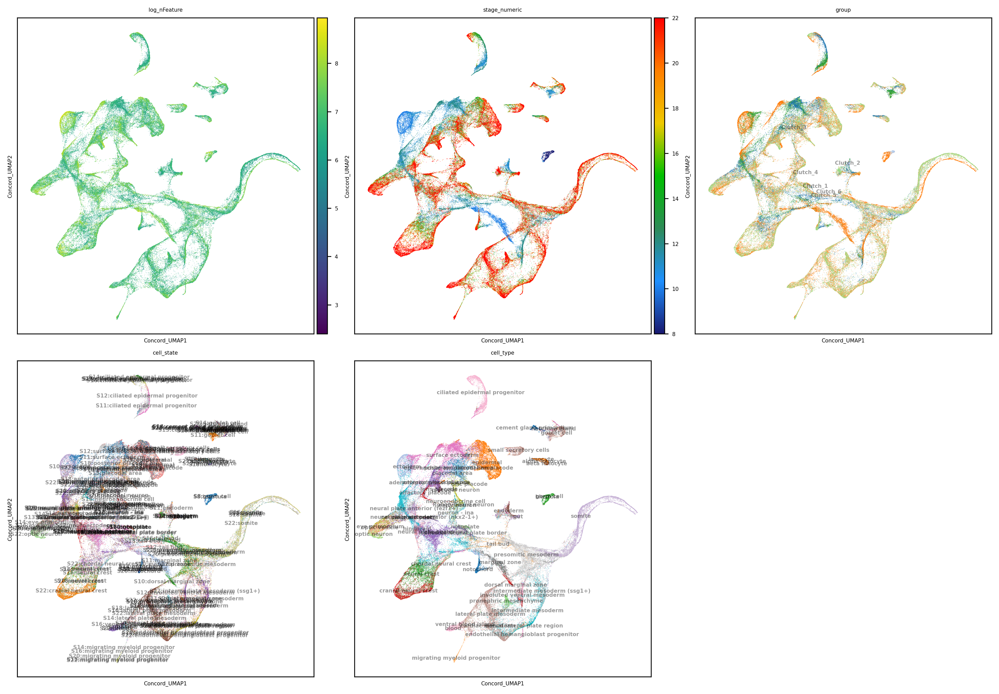

In [71]:
ccd.ul.run_umap(adata, source_key=output_key, umap_key=f'{output_key}_UMAP', n_components=2, n_neighbors=30, min_dist=0.1, metric='euclidean', random_state=seed)
show_basis = f'{output_key}_UMAP'
show_cols = ['log_nFeature', 'stage_numeric', 'group', 'cell_state', 'cell_type']
pal = {'log_nFeature':'viridis', 'stage_numeric':'BlueGreenRed', 'group':'tab20', 'cell_state':'tab20', 'cell_type':'tab20'}
ccd.pl.plot_embedding(
    adata, show_basis, show_cols, pal = pal, figsize=(13,9), dpi=300, ncols=3, font_size=5, point_size=.5, alpha=1.0, text_alpha=0.4, legend_loc='on data',
    save_path=save_dir / f"{show_basis}_{file_suffix}.png"
)

### 3D UMAP

It is best to use 3D UMAP rather than 2D to visualize Concord latent, because 2D may not be enough to 'unpack' the complex structures learned by Concord, thus tends to break trajectories.

In [73]:
import plotly.io as pio
pio.renderers.default = 'notebook'
#ccd.ul.run_umap(adata,  source_key=output_key, umap_key=f'{output_key}_UMAP_3D', n_components=3, n_neighbors=15, min_dist=0.1, metric='euclidean')
show_basis = f'{output_key}_UMAP_3D'
#show_cols = ['log_nFeature', 'stage_numeric', 'group', 'cell_state', 'cell_type']
show_col = 'stage_numeric'
ccd.pl.plot_embedding_3d(
    adata, basis=show_basis, color_by=show_col,
    pal = pal,
    save_path=save_dir / f'{output_key}_UMAP_3D_{file_suffix}.html',
    point_size=1, opacity=0.8, width=1500, height=1000
)

Concord - INFO - 3D plot saved to ../save/dev_concord_xenopus_embryogenesis-Oct01/Concord_UMAP_3D_concord_xenopus_embryogenesis_Oct01-2000_stage_numeric.html


In [74]:
show_col = 'cell_type'
ccd.pl.plot_embedding_3d(
    adata, basis=show_basis, color_by=show_col,
    pal = pal,
    save_path=save_dir / f'{output_key}_UMAP_3D_{file_suffix}.html',
    point_size=1, opacity=0.8, width=1500, height=1000
)

Concord - INFO - 3D plot saved to ../save/dev_concord_xenopus_embryogenesis-Oct01/Concord_UMAP_3D_concord_xenopus_embryogenesis_Oct01-2000_cell_type.html


## Save the result

In [75]:
obsm_filename = save_dir / f"obsm_{file_suffix}.h5"
ccd.ul.save_obsm_to_hdf5(adata, obsm_filename)
adata.write_h5ad(f"{data_path}/{proj_name}_{file_suffix}.h5ad")

You can optionally convert the result to VisCello (https://github.com/kimpenn/VisCello) for interactive exploration.

In [77]:
ccd.ul.anndata_to_viscello(adata, f'{data_path}/cello_{proj_name}_{file_suffix}', project_name = proj_name, organism='xtr')